In [27]:
import sklearn
import numpy as np
import os
import pandas as pd
from pathlib import Path

import matplotlib.pyplot as plt
import seaborn as sns

import librosa
import librosa.display

import handcalcs.render


In [25]:
# example load
# 1st variable = waveform, 2nd = sampling rate
fire, fire_sampling_rate1 = librosa.load('../data/train/firetruck/sound_201.wav')
ambu, ambu_sampling_rate1 = librosa.load('../data/train/ambulance/sound_106.wav')

print(type(fire), type(fire_sampling_rate1))
print('waveform: {} - sampling rate: {}'.format(fire,fire_sampling_rate1))


<class 'numpy.ndarray'> <class 'int'>
waveform: [ 0.109225    0.11870955  0.05889557 ... -0.22628519 -0.20394854
 -0.1803268 ] - sampling rate: 22050


Sampling rate or sampling frequency defines the number of samples per second (or per other unit) taken from a continuous signal to make a discrete or digital signal.

In [28]:
#load complete trainings data

folders = ['ambulance', 'firetruck', 'traffic']

ambulance = []
firetruck = []
traffic = []


for x in range(len(folders)):
    path = '../data/train/' + folders[x]
    p = Path(path)
    for f in p.rglob('*.wav'):
        if x == 0:
            ambulance.append(f)
        if x == 1:
            firetruck.append(f)
        if x == 2:
            traffic.append(f)


# Spectogram

A spectrogram is a visual way of representing the signal strength, or “loudness”, of a signal over time at various frequencies present in a particular waveform.  Not only can one see whether there is more or less energy at, for example, 2 Hz vs 10 Hz, but one can also see how energy levels vary over time. 

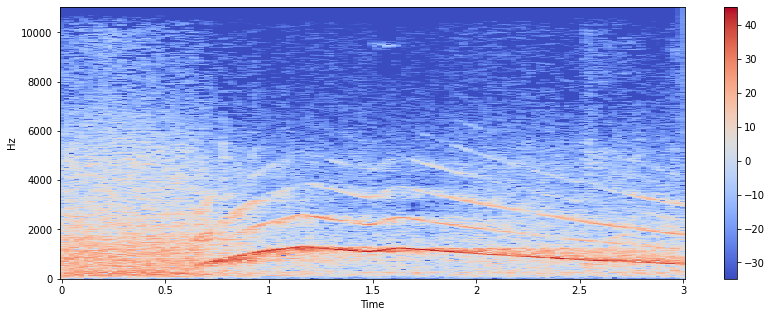

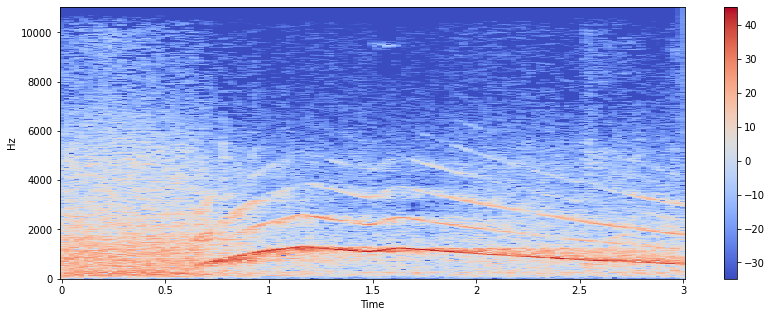

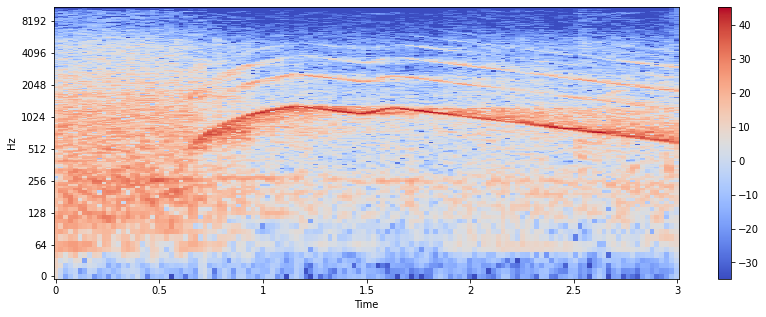

In [31]:
X = librosa.stft(fire)  # converts into  short term Fourier transform
Xdb = librosa.amplitude_to_db(abs(X))
plt.figure(figsize=(14, 5))
librosa.display.specshow(Xdb, sr=fire_sampling_rate1,
                         x_axis='time', y_axis='hz')
plt.colorbar()
plt.show()
plt.figure(figsize=(14, 5))

librosa.display.specshow(Xdb, sr=fire_sampling_rate1,
                         x_axis='time', y_axis='linear')
plt.colorbar()
plt.show()
plt.figure(figsize=(14, 5))

librosa.display.specshow(Xdb, sr=fire_sampling_rate1,
                         x_axis='time', y_axis='log')
plt.colorbar()
plt.show()

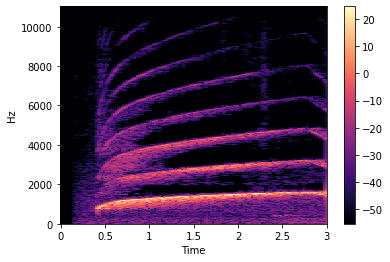

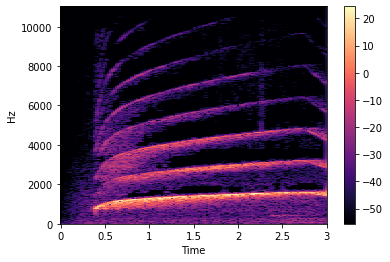

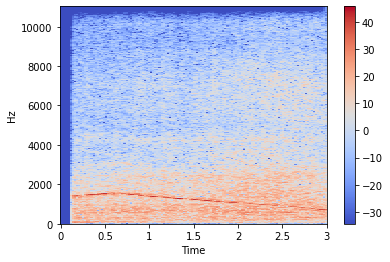

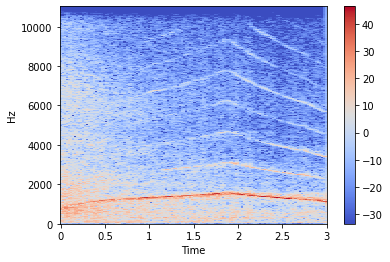

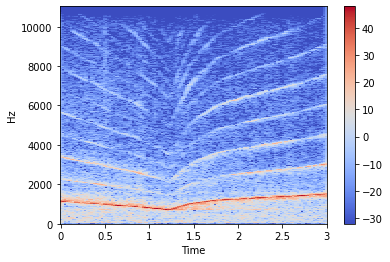

...

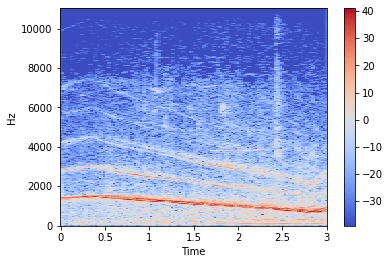

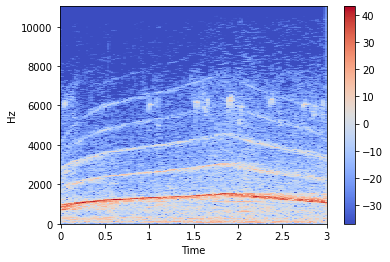

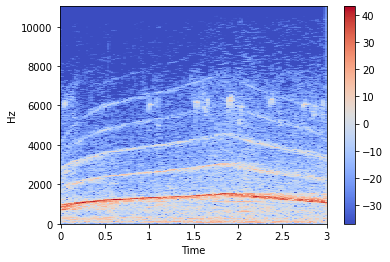

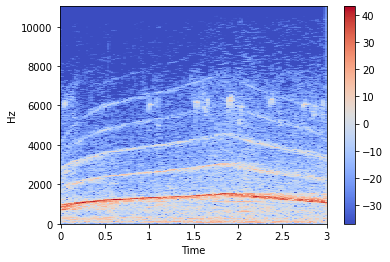

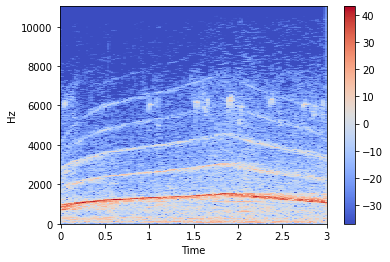

In [41]:

for a in ambulance:
    a, a_s = librosa.load(a)
    X = librosa.stft(a)  # converts into  short term Fourier transform
    Xdb = librosa.amplitude_to_db(abs(X))
    #plt.figure(figsize=(14, 5))
    librosa.display.specshow(Xdb, sr=a_s,
                             x_axis='time', y_axis='hz')
    plt.colorbar()
    plt.show()


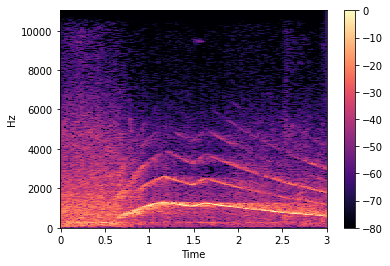

In [5]:
# ---- db 0 to -80
D = librosa.stft(fire)  # STFT of fire
S_db = librosa.amplitude_to_db(np.abs(D), ref=np.max)

plt.figure()
librosa.display.specshow(S_db, sr=fire_sampling_rate1,
                         x_axis='time', y_axis='hz')
plt.colorbar()
plt.show()



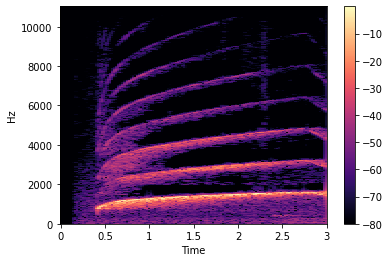

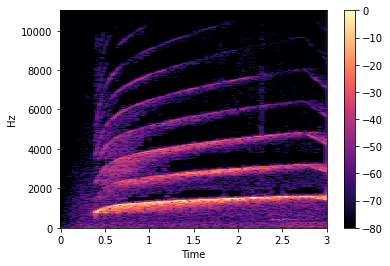

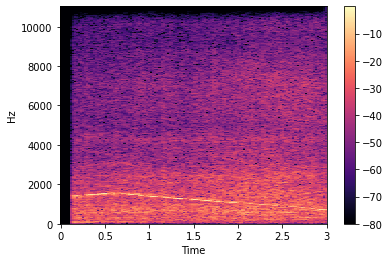

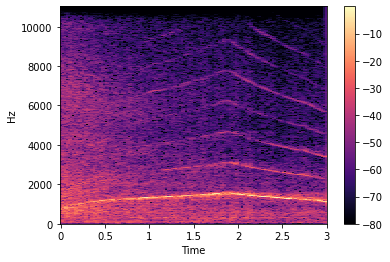

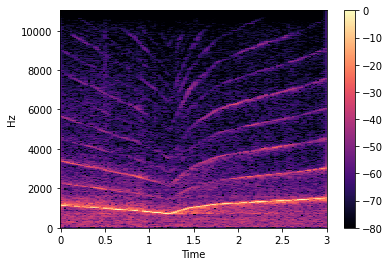

...

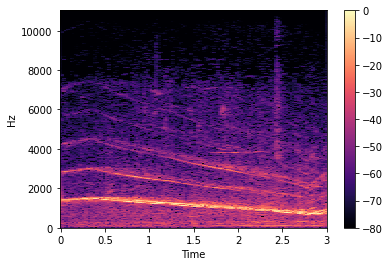

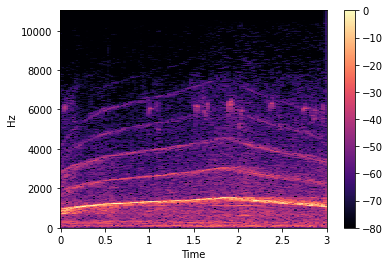

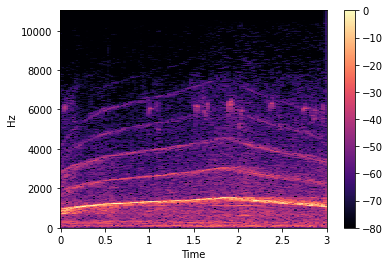

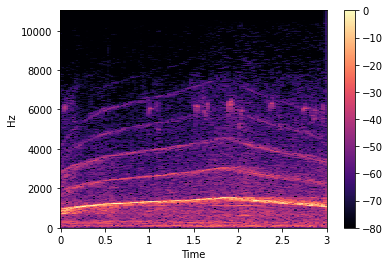

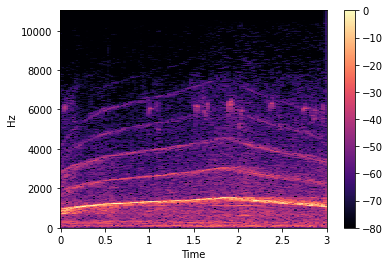

In [42]:
for a in ambulance:
    a, a_s = librosa.load(a)
    D = librosa.stft(a)  # converts into  short term Fourier transform
    S_db = librosa.amplitude_to_db(np.abs(D), ref=np.max)
    #plt.figure(figsize=(14, 5))
    librosa.display.specshow(S_db, sr=a_s,
                             x_axis='time', y_axis='hz')
    plt.colorbar()
    plt.show()


# zero crossing rate

https://citeseerx.ist.psu.edu/viewdoc/download?doi=10.1.1.1048.7729&rep=rep1&type=pdf



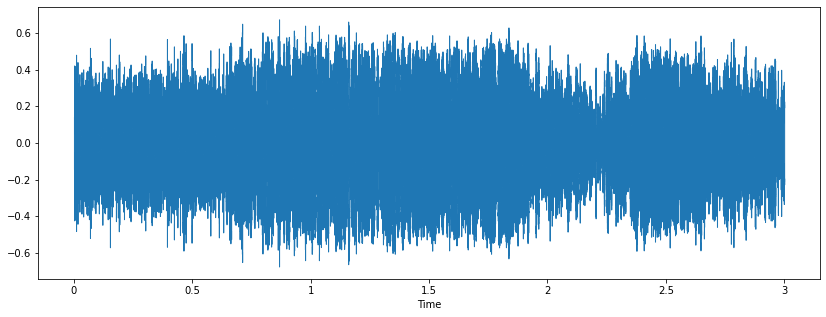

In [8]:
# Plot the signal:
plt.figure(figsize=(14, 5))
librosa.display.waveshow(fire, sr=fire_sampling_rate1)
plt.show()


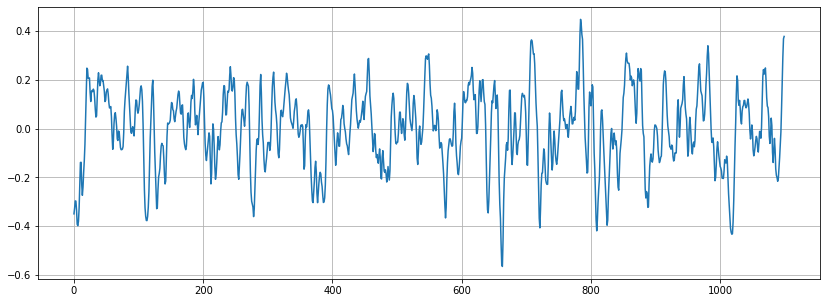

109
6201
8492


In [9]:

# zooming
n0 = 8000
n1 = 9100
plt.figure(figsize=(14, 5))
plt.plot(fire[n0:n1])
plt.grid()
plt.show()

# calculating zero crossing with limits
zero_crossings = librosa.zero_crossings(fire[n0:n1], pad=False)
print(sum(zero_crossings))

# complete for fire
zero_crossings = librosa.zero_crossings(fire, pad=False)
print(sum(zero_crossings))

# complete for ambu
zero_crossings = librosa.zero_crossings(ambu, pad=False)
print(sum(zero_crossings))



In [74]:
data_ambu = []
for f in ambulance:
    try:
        a, a_s = librosa.load(f)
        zero_crossings = librosa.zero_crossings(a, pad=False)

        data_ambu.append([str(f),'ambu',sum(zero_crossings)])
    except:
        print(f)


0.109225
0.11870955
0.058895566
0.05549735
0.08874511
0.14263079
0.13420159
0.12026183
0.077494964
0.041135766
0.04296153
0.09586499
0.15958697
0.22272332
0.2552888
0.31961796
0.38679588
0.40066683
0.4220889
0.41416264
0.3655579
0.29096153
0.22611378
0.17230414
0.12197005
0.089071624
0.09266489
0.09156095
0.08190516
0.068019964
0.003086828
-0.05634265
-0.08956028
-0.12108276
-0.13232058
-0.12249896
-0.109948836
-0.09040755
-0.09412981
-0.10698898
-0.09694011
-0.08705411
-0.07359884
-0.03999895
0.038411357
0.13427249
0.22945873
0.33294445
0.39161733
0.3687198
0.2831091
0.21885802
0.19100863
0.18020196
0.17491895
0.18621798
0.2156073
0.19913472
0.18461238
0.20520577
0.22740838
0.18004656
0.095859036
0.051382393
0.02214614
-0.0044733686
-0.06183596
-0.14553888
-0.19557452
-0.2151265
-0.22984414
-0.23905699
-0.23056087
-0.18244709
-0.11863006
-0.075404204
-0.02678949
0.033515606
0.05711664
0.054652397
0.062418964
0.05766864
0.024456762
-0.0125988405
-0.005964401
0.019763818
-0.0008188101
-

-0.17905381
-0.05967094
0.072289154
0.19068639
0.26501882
0.31671914
0.3718224
0.43332326
0.49161568
0.5284088
0.55281353
0.55014175
0.49911284
0.40913218
0.3066441
0.21269232
0.11404999
0.0009791157
-0.11766966
-0.2190938
-0.29721183
-0.34910232
-0.35458952
-0.31434128
-0.24132295
-0.16503952
-0.11358368
-0.08519816
-0.05553652
-0.009756924
0.04731401
0.1194486
0.20005938
0.27457604
0.31545115
0.30952072
0.27436534
0.22697933
0.18047762
0.12278616
0.055713404
-0.0120034795
-0.06657719
-0.10387017
-0.13235667
-0.14558855
-0.15913081
-0.1705995
-0.16607016
-0.14462838
-0.12683369
-0.13283697
-0.16474642
-0.18779206
-0.17564994
-0.15347897
-0.12896687
-0.102247566
-0.063077815
-0.029899448
-0.037803978
-0.06939609
-0.0981598
-0.10734125
-0.082677715
-0.027559921
0.042718876
0.09412952
0.100684516
0.07703207
0.06436854
0.092361815
0.14962533
0.20407835
0.22908378
0.21422505
0.15343046
0.042494744
-0.10027928
-0.21856958
-0.2764105
-0.28904316
-0.28826785
-0.3080069
-0.34253877
-0.37204576

-0.2605235
-0.20827213
-0.11218988
0.024134334
0.15573849
0.22599871
0.2161358
0.17648637
0.15216723
0.14543955
0.14757538
0.13958354
0.11509787
0.060677927
-0.02287772
-0.11644292
-0.19206834
-0.23137477
-0.2390061
-0.22167774
-0.16840726
-0.0659754
0.050939254
0.12689742
0.13342755
0.098671325
0.067881435
0.052970763
0.04232647
0.029808797
0.015886048
-0.008657936
-0.05494368
-0.122899316
-0.18059729
-0.20450282
-0.19302547
-0.15649483
-0.09824129
-0.005440435
0.10554769
0.18606469
0.20812477
0.18433739
0.14109597
0.11488458
0.097856015
0.06692436
0.021655912
-0.029530494
-0.079144776
-0.13531922
-0.18564412
-0.2167237
-0.21896732
-0.191129
-0.13674279
-0.04600764
0.070724264
0.16811216
0.20626302
0.18329592
0.14082061
0.120212205
0.11418631
0.09139058
0.043875005
-0.01453281
-0.084533215
-0.15688375
-0.20657542
-0.22477588
-0.21407813
-0.18273547
-0.12103325
-0.014233885
0.124016
0.2568695
0.33265653
0.32648557
0.25754908
0.17771699
0.12458298
0.08762485
0.03747092
-0.044310298
-0.1

-0.3775206
-0.28066328
-0.14113535
0.021516839
0.1474408
0.2144179
0.25169915
0.2612487
0.2653574
0.2515086
0.2233824
0.22758327
0.27517635
0.3427823
0.38347244
0.36210188
0.27753174
0.15869321
0.041273743
-0.06496763
-0.14659466
-0.18912077
-0.20938095
-0.21144882
-0.22172076
-0.25178176
-0.29151234
-0.34149498
-0.37476012
-0.367904
-0.3039991
-0.18797506
-0.04736802
0.06268195
0.13104542
0.1679054
0.20038532
0.2342213
0.24634638
0.2586993
0.29487202
0.36977875
0.4459652
0.4870647
0.47834545
0.41953132
0.32984045
0.22498928
0.1040532
-0.009517818
-0.10683366
-0.17749754
-0.23884286
-0.31054154
-0.37401044
-0.43216777
-0.4620987
-0.46901783
-0.44922552
-0.39098606
-0.29231578
-0.165738
-0.039076786
0.076131314
0.1715946
0.2355447
0.26135018
0.27001062
0.2925543
0.31702352
0.33308655
0.34894228
0.36155227
0.35975546
0.3168851
0.22710925
0.11438417
0.0008408012
-0.10363964
-0.19212613
-0.26642373
-0.31305757
-0.3325849
-0.32943696
-0.32038346
-0.33333018
-0.34990636
-0.35263428
-0.328341

In [77]:
data_fire = []
for f in firetruck:
    try:
        a, a_s = librosa.load(f)
        zero_crossings = librosa.zero_crossings(a, pad=False)

        data_fire.append([str(f),'fire',sum(zero_crossings)])
    except:
        print(f)

In [75]:
df_ambu = pd.DataFrame(columns=['filename','class','zero_crossing_count'],data=data_ambu)
df_ambu.describe()



,zero_crossing_count
count,201.000000
mean,7553.273632
std,1348.345108
min,3686.000000
25%,6757.000000
50%,7545.000000
75%,8340.000000
max,12583.000000


In [78]:
df_fire = pd.DataFrame(columns=['filename','class','zero_crossing_count'],data=data_fire)
df_fire.describe()

,zero_crossing_count
count,204.000000
mean,8832.955882
std,1801.293239
min,4559.000000
25%,7663.750000
50%,8783.500000
75%,9881.000000
max,16459.000000


# Spectral Centroid

https://www.researchgate.net/profile/Hadis-Nosrati/publication/264986258_Investigation_of_Spectral_Centroid_Magnitude_and_Frequency_for_Speaker_Recognition/links/53faf9150cf2e3cbf565e839/Investigation-of-Spectral-Centroid-Magnitude-and-Frequency-for-Speaker-Recognition.pdf

Spectral centroid frequency (SCF) is the weighted average frequency for a given subband, where the weights are the normalized energy of each frequency component in that subband.
Since this measure captures the center of gravity of each subband, it can detect the approximate location of formants, which
are manifested as peaks in neighbouring subband. However, the center of gravity of a subband is also affected by the
harmonic structure and pitch frequencies produced by the vocal source particularly for narrow bandwidths.

/tmp/ipykernel_3119/2163798247.py:4: FutureWarning: Pass y=[ 0.109225    0.11870955  0.05889557 ... -0.22628519 -0.20394854
 -0.1803268 ] as keyword args. From version 0.10 passing these as positional arguments will result in an error
  spectral_centroids = librosa.feature.spectral_centroid(


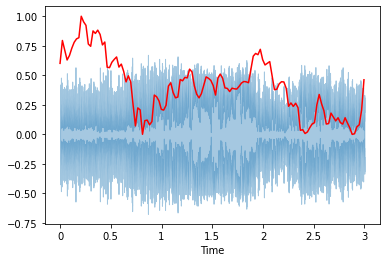

In [13]:
# spectral centroid -- centre of mass -- weighted mean of the frequencies present in the sound
spectral_centroids = librosa.feature.spectral_centroid(
    fire, sr=fire_sampling_rate1)[0]
spectral_centroids.shape
# Computing the time variable for visualization
frames = range(len(spectral_centroids))
t = librosa.frames_to_time(frames)
# Normalising the spectral centroid for visualisation


def normalize(x, axis=0):
    return sklearn.preprocessing.minmax_scale(x, axis=axis)


# Plotting the Spectral Centroid along the waveform
librosa.display.waveshow(fire, sr=fire_sampling_rate1, alpha=0.4)
plt.plot(t, normalize(spectral_centroids), color='r')
plt.show()

#@Todo: Test different between classes

# Mel-Frequency Cepstral Coefficients

https://www.researchgate.net/profile/Golam-Rabbani/publication/255574793_Speaker_Identification_Using_Mel_Frequency_Cepstral_Coefficients/links/55f05d5908ae0af8ee1d1894/Speaker-Identification-Using-Mel-Frequency-Cepstral-Coefficients.pdf

(20, 130)


/tmp/ipykernel_3119/209674595.py:3: FutureWarning: Pass y=[ 0.109225    0.11870955  0.05889557 ... -0.22628519 -0.20394854
 -0.1803268 ] as keyword args. From version 0.10 passing these as positional arguments will result in an error
  mfccs = librosa.feature.mfcc(fire, sr=fire_sampling_rate1)


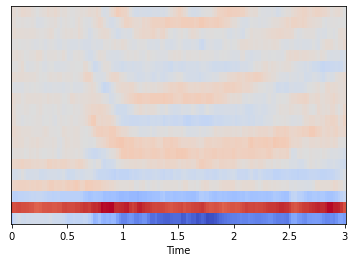

In [14]:
mfccs = librosa.feature.mfcc(fire, sr=fire_sampling_rate1)
print(mfccs.shape)
# Displaying  the MFCCs:
librosa.display.specshow(mfccs, sr=fire_sampling_rate1, x_axis='time')
plt.show()

# Chromagram

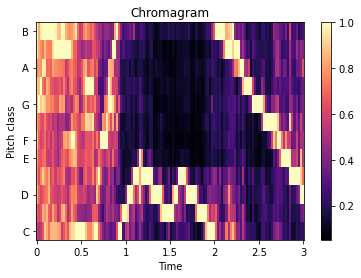

In [15]:
chroma = librosa.feature.chroma_cqt(y=fire, sr=fire_sampling_rate1)
fig, ax = plt.subplots()
img = librosa.display.specshow(chroma, y_axis='chroma', x_axis='time', ax=ax)
ax.set(title='Chromagram')
fig.colorbar(img, ax=ax)
plt.show()

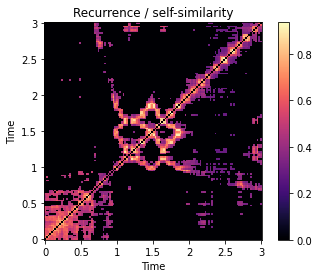

In [16]:
# time by time
R = librosa.segment.recurrence_matrix(chroma, mode='affinity')
fig, ax = plt.subplots()
img = librosa.display.specshow(R, y_axis='time', x_axis='time', ax=ax)
ax.set(title='Recurrence / self-similarity')
fig.colorbar(img, ax=ax)
fig.show()

# constant-Q transform

https://iem.kug.ac.at/fileadmin/media/iem/projects/2010/smc10_schoerkhuber.pdf

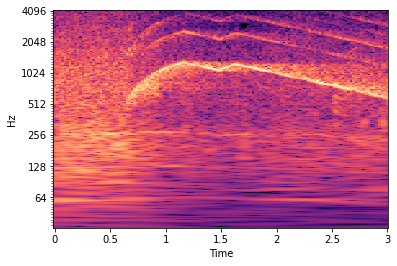

In [17]:
# plot a log-power CQT
BINS_PER_OCTAVE = 12 * 3
N_OCTAVES = 7
C = librosa.amplitude_to_db(np.abs(librosa.cqt(y=fire, sr=fire_sampling_rate1,
                                               bins_per_octave=BINS_PER_OCTAVE,
                                               n_bins=N_OCTAVES * BINS_PER_OCTAVE)),
                            ref=np.max)

fig, ax = plt.subplots()
librosa.display.specshow(C, y_axis='cqt_hz', sr=fire_sampling_rate1,
                         bins_per_octave=BINS_PER_OCTAVE,
                         x_axis='time', ax=ax)

plt.show()



# beat-synchronous the CQT

TypeError: Dimensions of C (84, 7) are incompatible with X (8) and/or Y (84); see help(pcolormesh)

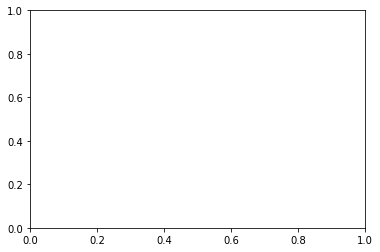

In [89]:
tempo, beats = librosa.beat.beat_track(y=fire, sr=fire_sampling_rate1, trim=False)
C = np.abs(librosa.cqt(y=fire, sr=fire_sampling_rate1))
Csync = librosa.util.sync(C, beats, aggregate=np.median)

# For plotting purposes, we'll need the timing of the beats
# we fix_frames to include non-beat frames 0 and C.shape[1] (final frame)
beat_times = librosa.frames_to_time(librosa.util.fix_frames(beats,
                                                            x_min=0,
                                                            x_max=C.shape[1]),
                                    sr=fire_sampling_rate1)

fig, ax = plt.subplots()
librosa.display.specshow(Csync, bins_per_octave=12*3,
                         y_axis='cqt_hz', x_axis='time',
                         x_coords=beat_times, ax=ax)

#plt.show()



In [92]:
Csync.shape

(84, 7)

# Periodogram

/usr/local/lib/python3.8/dist-packages/matplotlib/cbook/__init__.py:1298: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


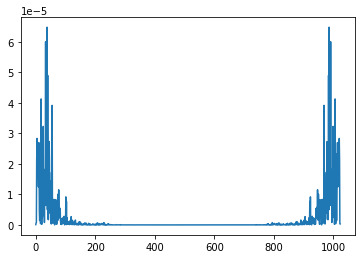

In [19]:
##

from scipy.fftpack import fft
def periodogram(x, win, Fs=None, nfft=1024):
    ''' Periodogram
    Periodogram power spectral density estimate
    The number of points, nfft, in the discrete Fourier transform (DFT) is the maximum of 256 or the next power of two greater than the signal length.
    :param x: time series data (e.g. audio signal), ideally length matches nfft
    :param win: window function to be applied (e.g. Hanning window). in this case win expects already data points of the window to be provided.
    :param Fs: sampling frequency (unused)
    :param nfft: number of bins for FFT (ideally matches length of x)
    :return: Periodogram power spectrum (np.array)
    '''

    # if Fs == None:
    #    Fs = 2 * np.pi         # commented out because unused

    U = np.dot(win.conj().transpose(), win)  # compensates for the power of the window.
    Xx = fft((x * win), nfft)  # verified
    P = Xx * np.conjugate(Xx) / U

    # Compute the 1-sided or 2-sided PSD [Power/freq] or mean-square [Power].
    # Also, compute the corresponding freq vector & freq units.

    # Generate the one-sided spectrum [Power] if so wanted
    if nfft % 2 != 0:
        select = np.arange((nfft + 1) / 2)  # ODD
        P = P[select, :]  # Take only [0,pi] or [0,pi)
        P[1:-1] = P[1:-1] * 2  # Only DC is a unique point and doesn't get doubled
    else:
        # select = np.arange(nfft/2+1);    # EVEN
        # P = P[select,:]         # Take only [0,pi] or [0,pi) # TODO: why commented out?
        P[1:-2] = P[1:-2] * 2

    P = P / (2 * np.pi)

    return P

perd = periodogram(fire,np.hamming(66150),fire_sampling_rate1)

plt.plot(perd)
plt.show()

### other papers

http://www2.ece.ohio-state.edu/~randy/SAtext/sm-slides-1ed.pdf